In [41]:
import geopandas
import matplotlib.pyplot as plt

import json
import pandas as pd
import numpy as np
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

import plotly.io as pio
pio.renderers.default = "notebook"

In [ ]:
# download shapefiles from 
# https://data.humdata.org/dataset/sierra-leone-all-ad-min-level-boundaries

# Shape files: provinces > district > chiefdom
province_shapefile = 'data/sle_admbnda_adm2_1m_gov_ocha/sle_admbnda_adm2_1m_gov_ocha_20161017.shp'
district_shapefile = 'data/sle_admbnda_adm1_1m_gov_ocha_20161017.shp/sle_admbnda_adm1_1m_gov_ocha_20161017.shp'
chiefdom_shapefile = 'data/sle_admbnda_adm3_1m_gov_ocha_20161017/sle_admbnda_adm3_1m_gov_ocha_20161017.shp'

## Plot Chiefdoms in GeoPandas

In [ ]:
prov = geopandas.read_file(province_shapefile)
dist = geopandas.read_file(district_shapefile)
chief = geopandas.read_file(chiefdom_shapefile)

,OBJECTID,admin3Name,admin3Pcod,admin3RefN,admin2Name,admin2Pcod,admin1Name,admin1Pcod,admin0Name,admin0Pcod,date,validOn,validTo,Shape_Leng,Shape_Area,Rowcacode0,Rowcacode1,Rowcacode2,Rowcacode3,geometry
0,1,Yakemu Kpukumu,SL030412,Yakemu Kpukumu,Pujehun,SL0304,Southern,SL03,Sierra Leone,SL,2016-08-01,2016-10-17,None,0.961890,0.014824,SLE,SLE003,SLE003004,SLE003004012,"MULTIPOLYGON (((-11.64561 7.25176, -11.64038 7..."
1,2,Koya,SL020412,Koya,Port Loko,SL0204,Northern,SL02,Sierra Leone,SL,2016-08-01,2016-10-17,None,2.324030,0.091659,SLE,SLE002,SLE002004,SLE002004012,"MULTIPOLYGON (((-12.93548 8.55549, -12.93455 8..."
2,3,Bureh Kasseh Ma,SL020401,Bureh Kasseh Ma,Port Loko,SL0204,Northern,SL02,Sierra Leone,SL,2016-08-01,2016-10-17,None,1.151700,0.034414,SLE,SLE002,SLE002004,SLE002004001,"POLYGON ((-12.79505 9.01480, -12.78941 9.01085..."
3,4,Panga Kabonde,SL030404,Panga Kabonde,Pujehun,SL0304,Southern,SL03,Sierra Leone,SL,2016-08-01,2016-10-17,None,1.650186,0.040759,SLE,SLE003,SLE003004,SLE003004004,"POLYGON ((-11.60700 7.57867, -11.60569 7.57638..."
4,5,Galliness Perri,SL030402,Galliness Perri,Pujehun,SL0304,Southern,SL03,Sierra Leone,SL,2016-08-01,2016-10-17,None,1.377624,0.048556,SLE,SLE003,SLE003004,SLE003004002,"POLYGON ((-11.52486 7.47723, -11.52486 7.47461..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
162,164,West I,SL040206,West I,Western Area Urban,SL0402,Western,SL04,Sierra Leone,SL,2016-08-01,2016-10-17,None,0.069520,0.000182,SLE,SLE004,SLE004002,SLE004002006,"POLYGON ((-13.24677 8.49345, -13.24669 8.49328..."
163,165,West II,SL040207,West II,Western Area Urban,SL0402,Western,SL04,Sierra Leone,SL,2016-08-01,2016-10-17,None,0.148607,0.000547,SLE,SLE004,SLE004002,SLE004002007,"POLYGON ((-13.25698 8.48552, -13.25685 8.48550..."
164,166,Gorama Kono,SL010305,Gorama Kono,Kono,SL0103,Eastern,SL01,Sierra Leone,SL,2016-08-01,2016-10-17,None,0.920976,0.026073,SLE,SLE001,SLE001003,SLE001003005,"POLYGON ((-11.10210 8.44301, -11.10487 8.43862..."
165,167,East III,SL040205,East III,Western Area Urban,SL0402,Western,SL04,Sierra Leone,SL,2016-08-01,2016-10-17,None,0.327120,0.003095,SLE,SLE004,SLE004002,SLE004002005,"POLYGON ((-13.20465 8.48576, -13.20461 8.48570..."


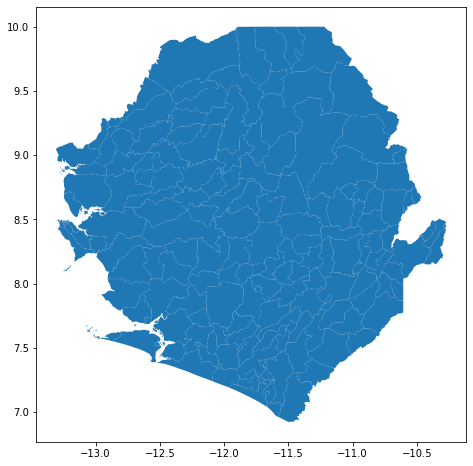

In [92]:
display(chief)
fig, ax = plt.subplots(1, figsize=(8, 8))
chief.plot(ax=ax)
# dist.boundary.plot(ax=ax, linewidth=3, color='black')
# prov.boundary.plot(ax=ax, linewidth=3, color='black')
# chief.boundary.plot(ax=ax, linewidth=1, color='red')

## Plot Chiefdoms in Plotly

Converting geopandas/shapefile to geojson, which plotly uses
https://community.plot.ly/t/create-your-own-choropleth-map-with-custom-shapefiles/2567/7

Plotly Choropleth maps
https://plot.ly/python/choropleth-maps/

In [26]:
# If your shapefile has coordinates in UTM format, 
# and you want to transform them into WGS84 (Lat / Lon format), you can do this:
# geodf = geodf.to_crs({'init': 'epsg:4326'})
print(chief.crs)

{'init': 'epsg:4326'}


In [31]:
chiefdom_geojson_filename = "data/chiefdom.geojson"
chief.to_file(chiefdom_geojson_filename, driver = "GeoJSON")
with open(chiefdom_geojson_filename) as fh:
    chief_geojson = json.load(fh)


In [47]:
# is there data in there? yes!
chief_geojson['features'][0]

{'type': 'Feature',
 'properties': {'OBJECTID': 1,
  'admin3Name': 'Yakemu Kpukumu',
  'admin3Pcod': 'SL030412',
  'admin3RefN': 'Yakemu Kpukumu',
  'admin2Name': 'Pujehun',
  'admin2Pcod': 'SL0304',
  'admin1Name': 'Southern',
  'admin1Pcod': 'SL03',
  'admin0Name': 'Sierra Leone',
  'admin0Pcod': 'SL',
  'date': '2016-08-01',
  'validOn': '2016-10-17',
  'validTo': None,
  'Shape_Leng': 0.961890332876,
  'Shape_Area': 0.0148237252858,
  'Rowcacode0': 'SLE',
  'Rowcacode1': 'SLE003',
  'Rowcacode2': 'SLE003004',
  'Rowcacode3': 'SLE003004012'},
 'geometry': {'type': 'MultiPolygon',
  'coordinates': [[[[-11.645612565999954, 7.251759443000026],
     [-11.640376725999943, 7.247178082000062],
     [-11.635468124999932, 7.247832562000042],
     [-11.63023228399993, 7.250123242000029],
     [-11.627941602999954, 7.252086683000073],
     [-11.621724041999926, 7.253395643000033],
     [-11.620087841999975, 7.253395643000033],
     [-11.615179240999964, 7.253395643000033],
     [-11.6102706399

In [65]:
fig = px.choropleth(
    chief,
    geojson=chief_geojson,
#     color='Shape_Area',  
    color='admin2Name',
    locations="OBJECTID", 
    featureidkey="properties.OBJECTID",
    )
# go.Figure()
fig.update_geos(fitbounds="locations", visible=False)
# fig.update_geos(lataxis_showgrid=True, lonaxis_showgrid=True)
fig.update_layout(mapbox_style="white-bg")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()


## Chiefdom Adjacency Data

GeoPandas GeoSeries objects have a "distance" function (from Shapely) that is used here to create an adjacency list for the chiefdoms.

In [84]:
# This takes a few minutes

# dist_to_objectid_1 = chief['geometry'].distance(chief['geometry'][0])
# chief.loc[dist_to_objectid_1==0, :]

# adjacency matrix
# for every chiefdom, calculate distance to geometry column.
# distance of 0 represents adjacency
num_chiefdoms = len(chief)
distmat = pd.DataFrame()
for i in range(num_chiefdoms)[:]:
    id_ = chief['OBJECTID'][i]
    print(id_, end=' ')
    dist = chief['geometry'].distance(chief['geometry'][i])
    distmat[id_] = dist
    


1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 

In [111]:
adjmat = distmat == 0
adjmat['OBJECTID1'] = chief['OBJECTID']
adj = adjmat.melt(id_vars=['OBJECTID1'], var_name='OBJECTID2')


adj = adj.loc[adj['value']].drop(columns=['value'])
adj = (adj.merge(chief.loc[:, ['OBJECTID', 'admin1Name', 'admin2Name', 'admin3Name']] , 
           how='left', left_on='OBJECTID1', right_on='OBJECTID')
    .drop(columns=['OBJECTID']).rename(columns={'admin1Name': 'OBJECTID1_admin1Name',
                                                'admin2Name': 'OBJECTID1_admin2Name',
                                                'admin3Name': 'OBJECTID1_admin3Name'})
    .merge(chief.loc[:, ['OBJECTID', 'admin1Name', 'admin2Name', 'admin3Name']] , 
           how='left', left_on='OBJECTID2', right_on='OBJECTID')
    .drop(columns=['OBJECTID']).rename(columns={'admin1Name': 'OBJECTID2_admin1Name',
                                                'admin2Name': 'OBJECTID2_admin2Name',
                                                'admin3Name': 'OBJECTID2_admin3Name'})
)
adj.tail(10)
adj.to_csv('data/sierra_leone_chiefdom_adjacency.csv', index=False)
adj

,OBJECTID1,OBJECTID2,OBJECTID1_admin1Name,OBJECTID1_admin2Name,OBJECTID1_admin3Name,OBJECTID2_admin1Name,OBJECTID2_admin2Name,OBJECTID2_admin3Name
0,1,1,Southern,Pujehun,Yakemu Kpukumu,Southern,Pujehun,Yakemu Kpukumu
1,4,1,Southern,Pujehun,Panga Kabonde,Southern,Pujehun,Yakemu Kpukumu
2,6,1,Southern,Pujehun,Kpaka,Southern,Pujehun,Yakemu Kpukumu
3,14,1,Southern,Bonthe,Kwamebai Krim,Southern,Pujehun,Yakemu Kpukumu
4,19,1,Southern,Pujehun,Mono Sakrim,Southern,Pujehun,Yakemu Kpukumu
...,...,...,...,...,...,...,...,...
1022,157,167,Western,Western Area Rural,Waterloo Rural,Western,Western Area Urban,East III
1023,160,167,Western,Western Area Urban,East I,Western,Western Area Urban,East III
1024,161,167,Western,Western Area Urban,East II,Western,Western Area Urban,East III
1025,167,167,Western,Western Area Urban,East III,Western,Western Area Urban,East III
